# RL experiments for Φ = 0.3, Ψ = 1.0
To begin, we will import the main functions and data structures defined in `main.ipynb` and define the parameters specific to this set of trials. For Φ = 0.3, Ψ = 1.0, swimming cells are moving quite slow (Φ) and are relatively easily rotated by vorticity (Ψ). Because Ψ ~ 1, we either expect close trajectories constrained to vortices or cells moving from vortex to vortex. 

In [83]:
%run main.ipynb

The line_profiler extension is already loaded. To reload it, use:
  %reload_ext line_profiler


In [22]:
paper=True

In [2]:
my_Φ = 0.3 # swimming number = v_s/u_0       
my_Ψ = 1.0  # stability number = B w_0. B is the characteristic time a perturbed cell takes to return 
            # to orientation ka if w = 0. smaller means swimming more aligned with ka. 
my_Ns = 4000
my_Ne = 5000
my_alpha = 1.0 
method = "expSARSA"
lr_decay = False
eps_decay = True
my_eps0 = 1.0

At this point, we can either upload an optimal policy (from a stored Q matrix) or carry out the training procedure.

In [4]:
# if planning to start from an "optimal Q" that has been written to file (.npy file in the Policies folder)
filename = 'Policies/Q_alpha_0d18_Ns_4000_Ne_5000_Φ_3d0_Ψ_3d0_eps_0_doubleQ_False_RIC_False_epsdecay_False.npy'
loadingFromFile = False
if filename and loadingFromFile:
    try: 
        Q = np.load(filename)
        print("Optimal Q matrix loaded.")
        smart, naive, R_tot_smart, R_tot_naive, chosen_actions = sample_trajectory(my_Φ, my_Ψ, Q, Ns = my_Ns)
    except FileNotFoundError:
        ans = input("File not found. Would you like to start training a model instead? (y/n)\n")
        if ans == "y":
            Q, Σ, smart, naive, hist_R_tot_smart, hist_R_tot_naive, smart_stored_histories, naive_stored_histories, \
                state_action_counter, chosen_actions, avg_Q_hist, initial_coords, theta_history \
                    = training(alpha=my_alpha, Φ=my_Φ, Ψ=my_Ψ, Ns=my_Ns, doubleQ=doubleQ, lr_decay=True, Ne=my_Ne, \
                        eps0=my_eps0, eps_decay=eps_decay, omega=my_omega)
            loadingFromFile = False
else:
    print("Training reinforcement learning model")
    Q, Σ, smart, naive, hist_R_tot_smart, hist_R_tot_naive, smart_stored_histories, naive_stored_histories, \
        state_action_counter, chosen_actions, avg_Q_hist, initial_coords, theta_history \
            = training(alpha0=my_alpha, Φ=my_Φ, Ψ=my_Ψ, Ns=my_Ns, method=method, lr_decay=lr_decay, Ne=my_Ne, \
                eps0=my_eps0, eps_decay=eps_decay)
    loadingFromFile = False
    

Training reinforcement learning model


Since these simulations take ~ 30 min, let's create a system by which we can save figures of different trials to keep track of the results.

In [6]:
# directory name for saving files
if not loadingFromFile:
    directory_name = "Φ_" + str(my_Φ).replace(".","d") + "_Ψ_" + str(my_Ψ).replace(".","d")
    try:
        directory_name = directory_name + "_" + "alpha_" + str(my_alpha).replace(".","d")
    except:
        pass
    if method=="doubleQ": directory_name = directory_name + "_doubleQ" 
    if method=="expSARSA": directory_name = directory_name + "_expSARSA" 
    if eps_decay: directory_name = directory_name + "_epsdecay" 
    if my_eps0 != 0: directory_name = directory_name + "_eps_" + str(my_eps0).replace(".","d")
    if lr_decay: directory_name = directory_name + "_lrdecay_" + str(my_omega)
    print(directory_name)
    if not os.path.exists('Figures/' + directory_name):
        os.makedirs('Figures/' + directory_name)

Φ_0d3_Ψ_1d0_alpha_1d0_expSARSA_eps_1d0


Aside: since these experiments take a decent amount of time (~ 30 min - 1 hr), it's useful to perform profiling. It turns out that some of the Numpy functions such as `np.linalg.norm` are quite expensive; this is why such expression have been substuted by more direct, albeit less reader-friendly, expressions in the `Swimmer` class. 

In [7]:
# %prun -s cumulative -q -l 10 -T prun training(alpha=my_alpha, Φ=my_Φ, Ψ=my_Ψ, Ns=my_Ns, \
#                                                                 doubleQ=doubleQ, RIC=True, Ne=10)
# print(open('prun', 'r').read())

# for information on prun: https://docs.python.org/3/library/profile.html#module-pstats
# see also https://towardsdatascience.com/speed-up-jupyter-notebooks-20716cbe2025 for profiling/timing

According to `%prun`, `update_kinematics()` appears to be the most expensive function. We can break its execution time down further through the use of the line-profiler `%lprun`

In [8]:
# dummy = Swimmer(Ns=4000)
# %lprun -f dummy.update_kinematics dummy.update_kinematics(Φ=my_Φ,Ψ=my_Ψ) 

Using the line-by-line profiler `%lprun`, we find that 55% of the time is spent in `calc_velocity()`.

In [9]:
# %lprun -f dummy.calc_velocity dummy.calc_velocity(Φ=my_Φ,Ψ=my_Ψ) 

For more information we can use the following magic command:

In [10]:
# ?%lprun

## Plot total reward as a function of the episode number

In [79]:
# check performance after training this agent with this set of parameters
%run main.ipynb
N = 1500
plot_total_reward_vs_episode(hist_R_tot_smart, hist_R_tot_naive, N , paper=True)

The line_profiler extension is already loaded. To reload it, use:
  %reload_ext line_profiler


## Plot learning gain over time

In [57]:
plot_learning_gain(hist_R_tot_smart, hist_R_tot_naive, N, paper=True)

From the above set of plots, we see that the swimmer first goes through a period of suboptimal performance (i.e. an exploration phase during which $\eps$ is still finite) before experiencing a substantial gain in performance as the Q matrix presmuably converges. 

## Visualize policy
To visualize the actions we will take for each state, we can alculate the matrix Qnorm, which is Q but each of its rows is normalized so as to range from 0 to 1. In this way, we can visualize the best action (column) for each state (row).

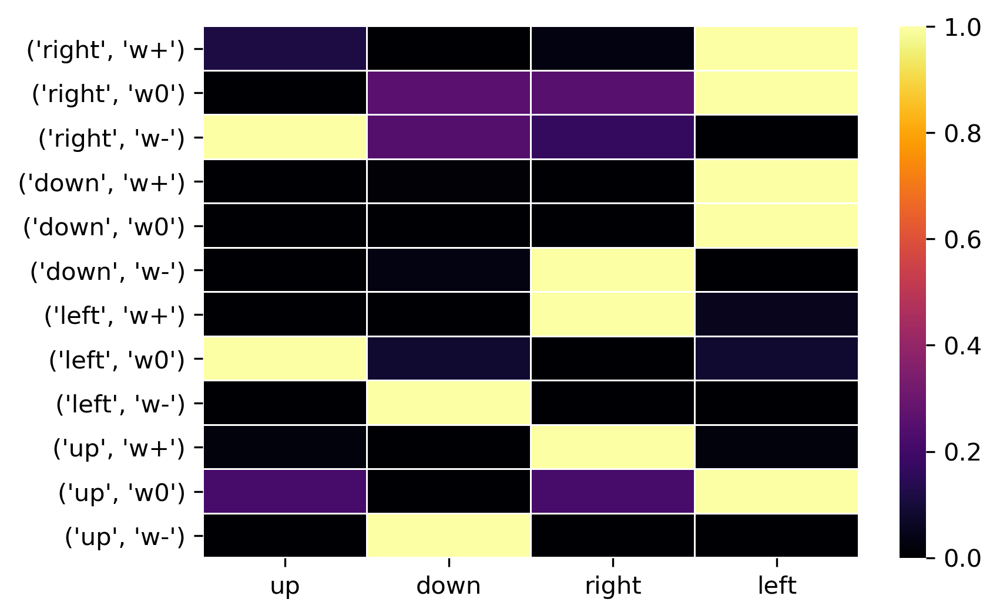

In [24]:
# plt.figure(figsize=(3,2))
Qnorm = copy.deepcopy(Q)
max_per_row = np.max(Q,1)
min_per_row = np.min(Q,1)
for row in range(Q.shape[0]):
    Qnorm[row,:] = (Qnorm[row,:]-min_per_row[row])/(max_per_row[row]-min_per_row[row])
ax = sns.heatmap(Qnorm, linewidth=0.5, xticklabels = ["up","down","right","left"], yticklabels = product_states, \
                cmap = 'inferno')
if not loadingFromFile: plt.savefig("Figures/" + directory_name + "/final-policy.pdf", format="pdf", bbox_inches="tight")
plt.show()
# print(Q)
# print(Qnorm)

Of course we can also visualize Q directly to a sense of the relative value of the state-action pairs.

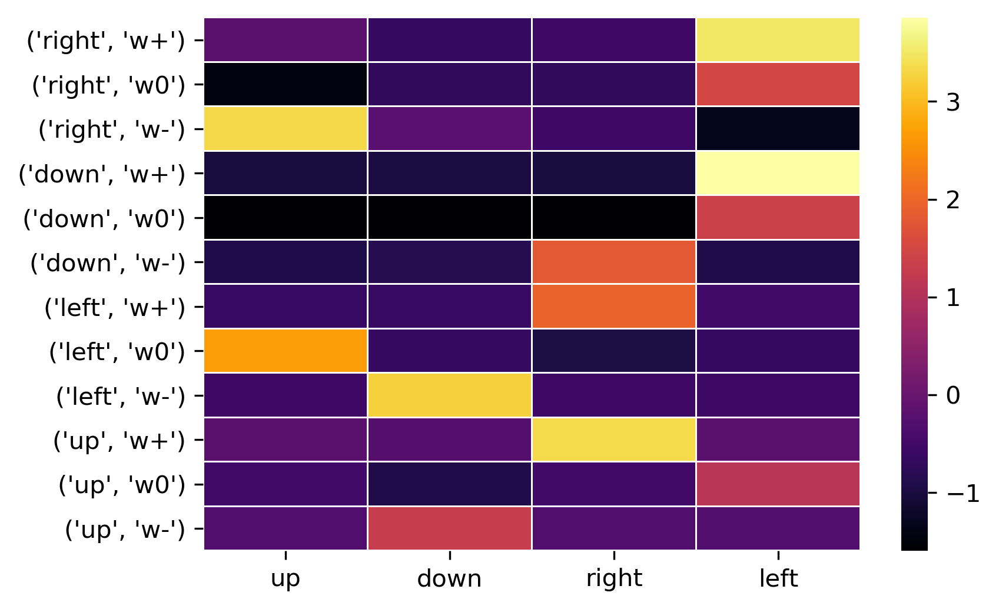

In [25]:
ax = sns.heatmap(Q, linewidth=0.5, xticklabels = ["up","down","right","left"], yticklabels = product_states, \
                cmap = 'inferno')
if not loadingFromFile: plt.savefig("Figures/" + directory_name + "/final-policy-unnorm.pdf", format="pdf", \
                                    bbox_inches="tight")

Another way we can visualize the "optimal" policy is to overlay the actions taken on the periodic flow field:

## Plot trajectories for for selected episodes

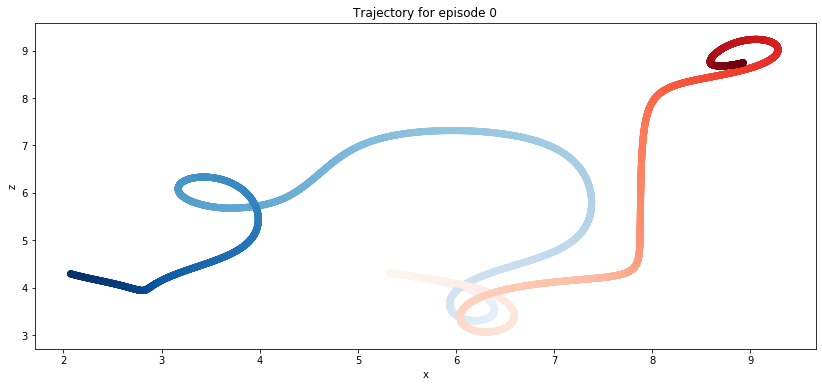

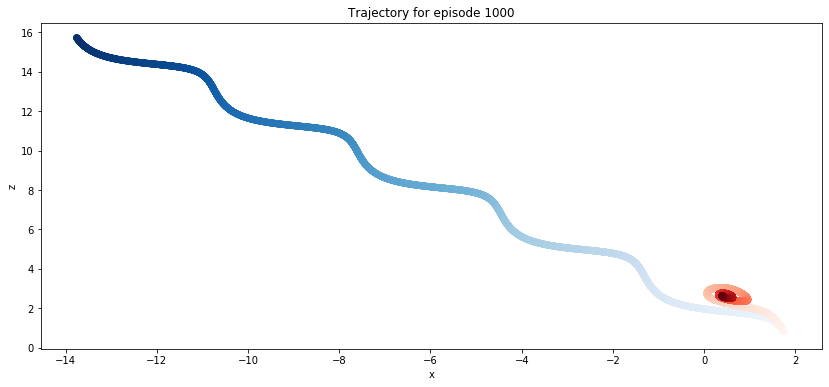

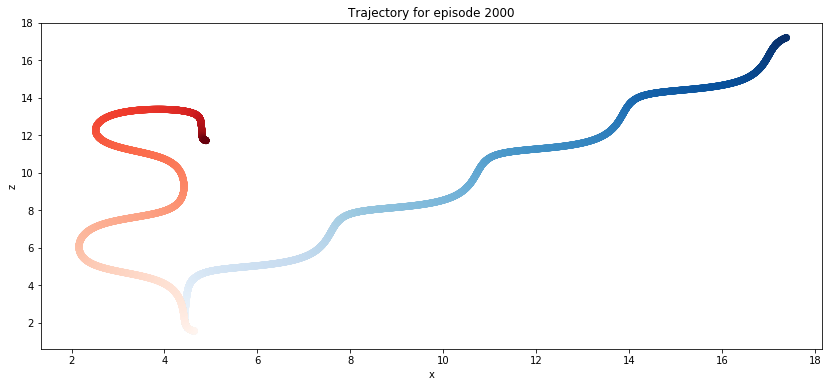

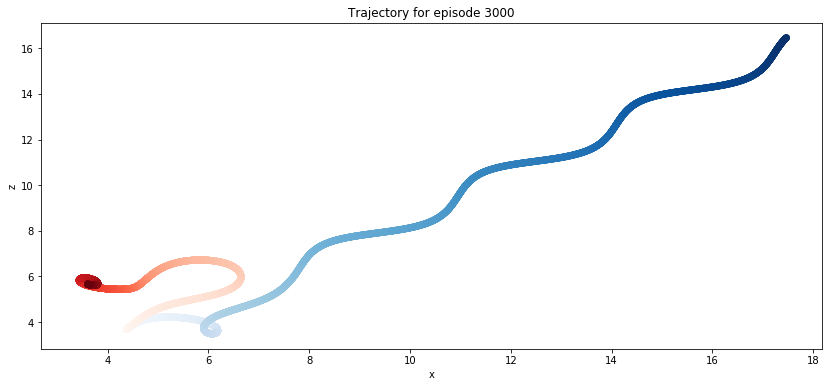

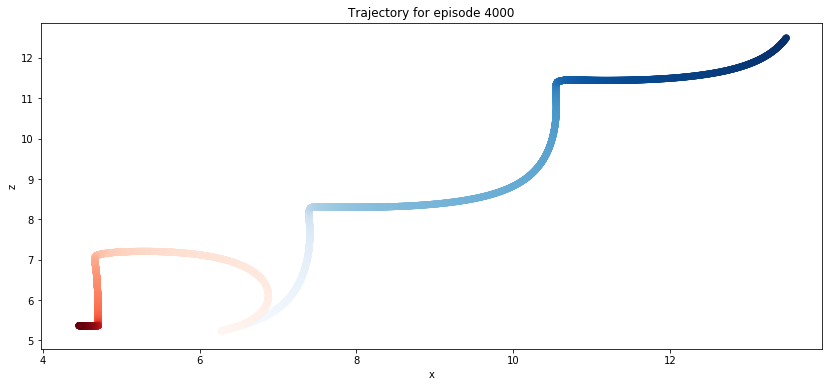

In [16]:
style = "matplotlib" # "plotly" or "matplotlib"

if not loadingFromFile:
    for i in range(len(smart_stored_histories)):
            ep, smart_history_X_total = smart_stored_histories[i]
            ep, naive_history_X_total = naive_stored_histories[i]

            if i == len(smart_stored_histories) - 1: style = "plotly"
            if style == "plotly":
                fig = go.Figure(go.Scatter(x=smart_history_X_total[:,0], y=smart_history_X_total[:,1],mode='markers',
                    name = "smart",
                    marker=dict(size=4,
                        color=np.linspace(0,my_Ns,my_Ns+1), #set color equal to a variable
                        colorscale='blues', # one of plotly colorscales
                        showscale=True,
                        colorbar=dict(title="Smart")
                    )))
                fig.add_trace(go.Scatter(x=naive_history_X_total[:,0], y=naive_history_X_total[:,1],mode='markers',
                    name = "naive",
                    marker=dict(size=4,
                        color=np.linspace(0,my_Ns,my_Ns+1), #set color equal to a variable
                        colorscale='reds', # one of plotly colorscales
                        showscale=True,
                        colorbar=dict(title="Naive",x=1.15)
                    )))
                fig.update_layout(
                    title="Trajectory for episode " + str(ep),
                    xaxis_title="$x$",
                    yaxis_title="$z$",
                    legend_orientation="h",
                    showlegend = False
                )
                fig.show()
            else:
                plt.figure(figsize=(14,6))
                plt.scatter(smart_history_X_total[:,0], smart_history_X_total[:,1], c=np.linspace(0,my_Ns,my_Ns+1), \
                            cmap='Blues')
                plt.scatter(naive_history_X_total[:,0], naive_history_X_total[:,1], c=np.linspace(0,my_Ns,my_Ns+1), \
                            cmap='Reds')
                plt.xlabel("x")
                plt.ylabel("z")
                plt.title("Trajectory for episode " + str(ep))
                plt.show()

    if i == len(smart_stored_histories) - 1: fig.write_image("Figures/" + directory_name + "/final-epsiode.pdf") 

From these select episodes, we see that progressively the smart gyrotactic particle learns how to escape the vortical structures that the naive particle consistently seems to end up in, thereby preventing further elavation increase. 

Let's try to visualize episode 4000 alongside the streamlines:

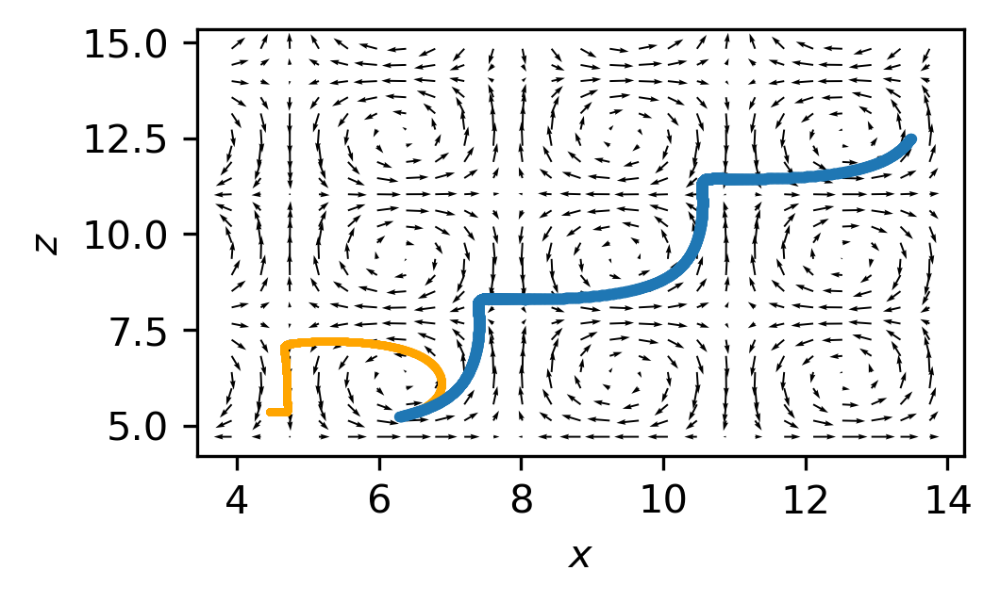

In [81]:
i = 4
ep, history_X = smart_stored_histories[i]

# create underlying quiver plot
plt.figure(figsize=(3.5, 2)) if paper else plt.figure(figsize=(14,6))
x = np.linspace(0.75*np.min(history_X[1:,0]), np.max(history_X[1:,0]*1.1), 25)
z = np.linspace(0.75*np.min(history_X[1:,1]), np.max(history_X[1:,1]*1.1), 25)
Z, X = np.meshgrid(x, z)
ux, uz, w = tgv(X, Z)
plt.quiver(X, Z, ux, uz)

# create scatter plot for policy
cmap = plt.get_cmap('viridis', 4)
_, naive_history_X = naive_stored_histories[i]
plt.scatter(naive_history_X[1:,0], naive_history_X[1:,1],s=1,color='orange')
# ax = plt.scatter(history_X[1:,0], history_X[1:,1],s=3,c=chosen_actions[:], cmap=cmap, \
#                  vmin = -.5, vmax = 3.5)
ax = plt.scatter(history_X[1:,0], history_X[1:,1],s=3)
# cbar = plt.colorbar(ticks=np.arange(0,4))
# cbar.ax.set_yticklabels(['Up', 'Down', 'Right','Left']) 
plt.xlabel(r'$x$')
plt.ylabel(r'$z$')
if not loadingFromFile: plt.savefig("Figures/" + directory_name + "/final-ep-actions.pdf", format="pdf", bbox_inches="tight")
plt.show()

### Final episode trajectory

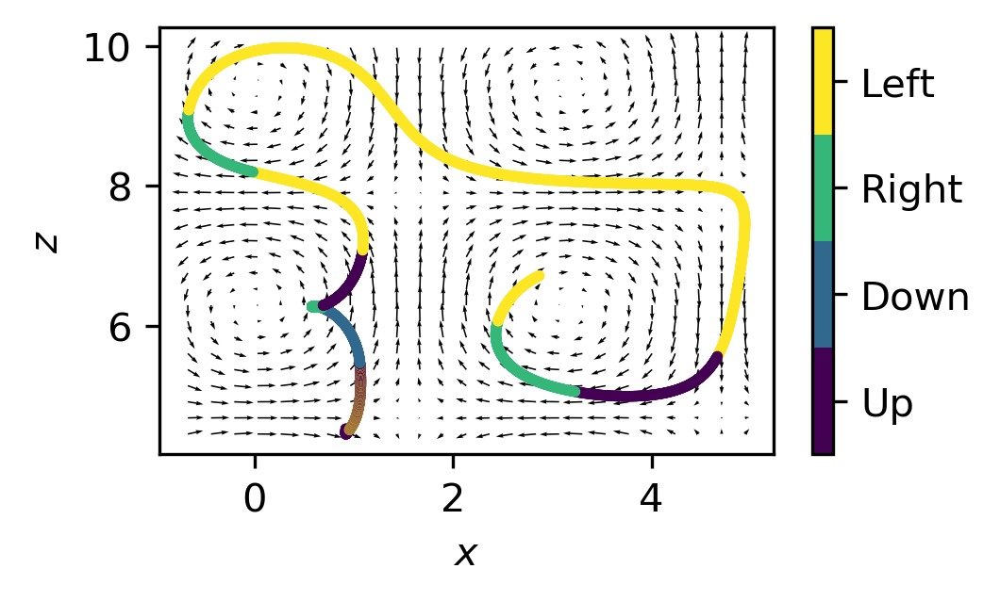

In [26]:
history_X = np.array(smart.history_X_total)

# create underlying quiver plot
plt.figure(figsize=(3.5, 2)) if paper else plt.figure(figsize=(14,6))
x = np.linspace(np.min(history_X[1:,0]), np.max(history_X[1:,0]), 25)
z = np.linspace(np.min(history_X[1:,1]), np.max(history_X[1:,1]), 25)
X, Z = np.meshgrid(x, z)
ux, uz, w = tgv(X, Z)
plt.quiver(X, Z, ux, uz)

# create scatter plot for policy
cmap = plt.get_cmap('viridis', 4)
ax = plt.scatter(history_X[1:,0], history_X[1:,1],s=3,c=chosen_actions[:], cmap=cmap, \
                 vmin = -.5, vmax = 3.5)
cbar = plt.colorbar(ticks=np.arange(0,4))
cbar.ax.set_yticklabels(['Up', 'Down', 'Right','Left']) 
plt.xlabel(r'$x$')
plt.ylabel(r'$z$')
plt.savefig("Figures/" + directory_name + "/final-ep-actions.pdf", format="pdf", bbox_inches="tight")
plt.show()

## Visualize strategy learned by smart gyrotactic particle

In [17]:
fig = go.Figure(data = go.Contour(x = x, y = z, z=w, colorscale='Gray', colorbar=dict(x=1,title="w")))

history_X = np.array(smart.history_X)

fig.add_trace(go.Scatter(x=history_X[:,0], y=history_X[:,1],mode='markers',
    marker=dict(
        size=4,
        color=np.linspace(0,my_Ns,my_Ns+1), #set color equal to a variable
        colorscale='plasma', # one of plotly colorscales
        showscale=True,
        colorbar=dict(x=1.1,title="Step")
    )))

fig.update_layout(
    title="Trajectory for the final episode",
    xaxis_title="$x$",
    yaxis_title="$z$",
    xaxis=dict(
        range=[0, L]
    ),
    yaxis=dict(
        range=[0, L]
    )
)

fig.show()
if not loadingFromFile: fig.write_image("Figures/" + directory_name + "/final-traj-periodic.pdf") 

## Convergence of Q-learning
Q-learning convergences in the limit that all state-action pairs have been visited infinitely many times. The heat map shown below shows us how often each state has been visited relative to the total number of visits. 

The state that was visited least had 21209.0 encounters, which is 0.11% of the total states visited


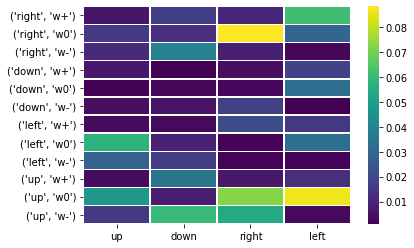

In [18]:
if not loadingFromFile:
    print("The state that was visited least had " + str(np.min(state_action_counter)) + " encounters, which is " + \
         str(round(np.min(state_action_counter)/np.sum(state_action_counter)*100,2)) + "% of the total states visited")
    
    # heatmap normalized by total number of encounters
    ax = sns.heatmap(state_action_counter/np.sum(state_action_counter), linewidth=0.5, \
                xticklabels = ["up","down","right","left"], yticklabels = product_states, cmap = 'viridis')


We should also check the distribution of initial states that were visted:

In [19]:
if not loadingFromFile:
    fig = go.Figure()
    fig.add_trace(go.Histogram(
        x=initial_coords[:,0],
        histnorm='probability density',
        name = 'x',
        xbins=dict(
            start=0,
            end=2*np.pi,
            size=2*np.pi/20
        ),
        opacity=0.75,
    ))

    fig.add_trace(go.Histogram(
        x=initial_coords[:,1],
        histnorm='probability density',
        name = 'z',
        xbins=dict(
            start=0,
            end=2*np.pi,
            size=2*np.pi/20
        ),
        opacity=0.75,
    ))

    fig.add_trace(go.Histogram(
        x=initial_coords[:,2],
        histnorm='probability density',
        name = r'$\theta$',
        xbins=dict(
            start=0,
            end=2*np.pi,
            size=2*np.pi/20
        ),
        opacity=0.75,
    ))

    fig.update_layout(
        title_text='Distribution of initial position and orientation', # title of plot
        xaxis_title_text='Value', # xaxis label
        yaxis_title_text='Count' # yaxis label
    )

    fig.show()
    fig.write_image("Figures/" + directory_name + "/initial-coords.pdf") 

These coordinates are reasonably well-distributed; perhaps running for additional episodes could lead to a gain in performance, however, as we further flatten these distributions and experience all possible initial states. 

## Additional plots
### Plot rewards for latest episode
This was useful when debugging but less informative for the working program since it only gives information for one particular episode.

In [20]:
fig = go.Figure()
fig.add_trace(go.Scatter(x=np.arange(my_Ns), y=naive.r, mode='lines', name = "Naive"))
fig.add_trace(go.Scatter(x=np.arange(my_Ns), y=smart.r, mode='lines', name = "Smart"))
fig.update_layout(
    title="Reward as a function of time. R_tot_naive = " + str(np.round(np.sum(naive.r),2)) + \
        " and R_tot_smart = " + str(np.round(np.sum(smart.r),2)),
    xaxis_title="Step #",
    yaxis_title="Reward, r",
)
fig.show()
if not loadingFromFile: fig.write_image("Figures/" + directory_name + "/final-ep-rewards.pdf") 

### Directly viewing the entires of Q
This could be a way to visualize if the matrix is converging, but the graphic is difficult to analyze given the number of entries of Q and the range of values they take on. 

In [21]:
if not loadingFromFile:
    fig = go.Figure()
    for state in range(avg_Q_hist.shape[1]):
        for action in range(avg_Q_hist.shape[2]):
            fig.add_trace(go.Scatter(x=np.arange(Ne),y=avg_Q_hist[:,state,action], mode='lines'))
    fig.update_layout(
        title="Convergence of Q matrix",
        xaxis_title="Episode #",
        yaxis_title="Entry of Q"
    )
    fig.show()
    fig.write_image("Figures/" + directory_name + "/q-conv.pdf") # save figure

For the report, we'd like to visualize a case where the smart particle outperforms the naive. Let's iterate until we find such a case:

In [91]:
delta = 0
while delta < 4.0: # 4.0 is approximate difference in total return once we have converged 
    smart, naive, R_tot_smart, R_tot_naive, chosen_actions, history_theta = sample_trajectory(Φ=my_Φ, Ψ=my_Ψ, Q=Q, Ns=4000, D0=0, Dr=0)
    delta = R_tot_smart - R_tot_naive

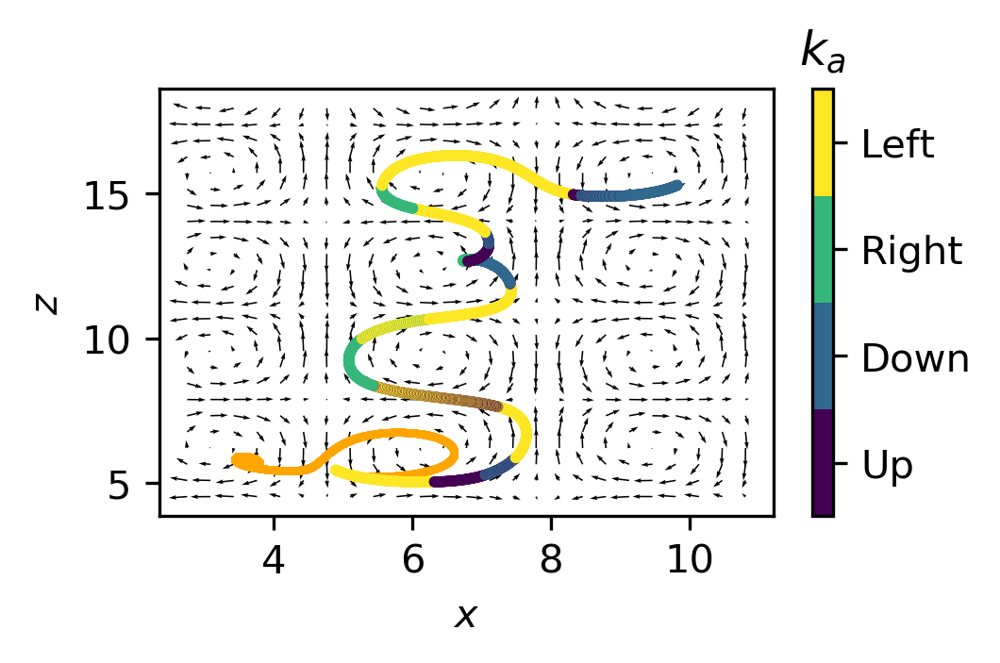

In [102]:
history_X = np.array(smart.history_X_total)
naive_history_X = np.array(naive.history_X_total)

# create underlying quiver plot
plt.figure(figsize=(3.5, 2)) if paper else plt.figure(figsize=(14,6))
x = np.linspace(0.8*np.min(naive_history_X ), np.max(history_X[1:,0]*1.1), 25)
z = np.linspace(0.9*np.min(history_X[1:,1]), np.max(history_X[1:,1]*1.1), 25)
X, Z = np.meshgrid(x, z)
ux, uz, w = tgv(X, Z)
plt.quiver(X, Z, ux, uz)

# create scatter plot for policy
cmap = plt.get_cmap('viridis', 4)
plt.scatter(naive_history_X[1:,0], naive_history_X[1:,1],s=1,color='orange')
ax = plt.scatter(history_X[1:,0], history_X[1:,1],s=3,c=chosen_actions[:], cmap=cmap, \
                 vmin = -.5, vmax = 3.5)
cbar = plt.colorbar(ticks=np.arange(0,4))
cbar.ax.set_yticklabels(['Up', 'Down', 'Right','Left']) 
cbar.ax.set_title(r'$k_a$')
plt.xlabel(r'$x$')
plt.ylabel(r'$z$')
plt.savefig("Figures/" + directory_name + "/final-ep-actions.png", format="png", dpi=600, bbox_inches="tight")
plt.show()

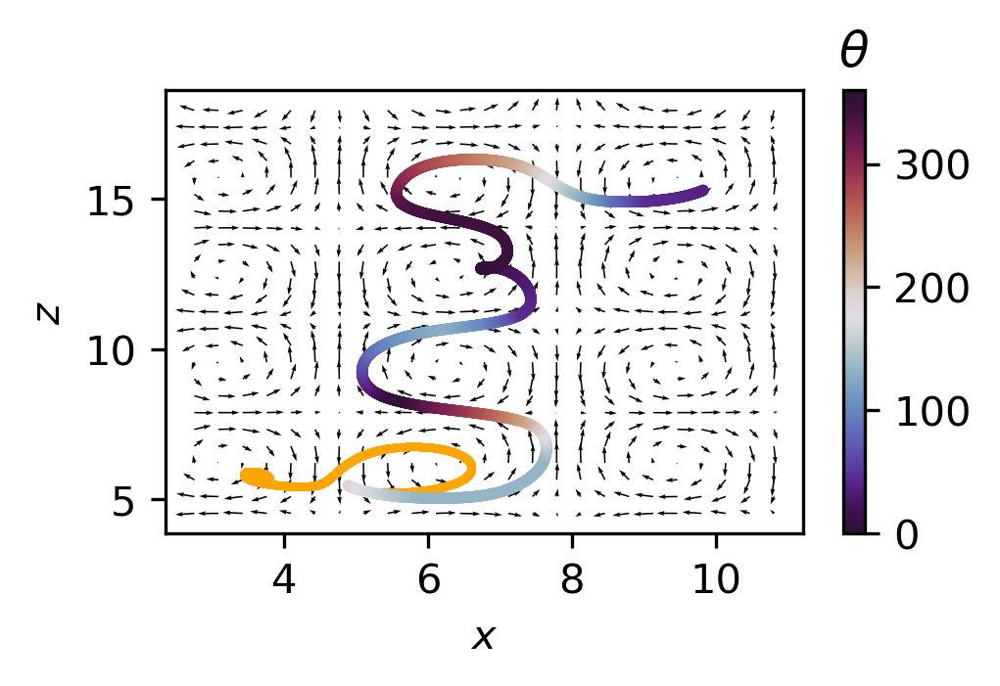

In [105]:
history_X = np.array(smart.history_X_total)
naive_history_X = np.array(naive.history_X_total)

# create underlying quiver plot
plt.figure(figsize=(3.5, 2)) if paper else plt.figure(figsize=(14,6))
x = np.linspace(0.8*np.min(naive_history_X ), np.max(history_X[1:,0]*1.1), 25)
z = np.linspace(0.9*np.min(history_X[1:,1]), np.max(history_X[1:,1]*1.1), 25)
X, Z = np.meshgrid(x, z)
ux, uz, w = tgv(X, Z)
plt.quiver(X, Z, ux, uz)

# create scatter plot for policy
plt.scatter(naive_history_X[1:,0], naive_history_X[1:,1],s=1,color='orange')
ax = plt.scatter(history_X[1:,0], history_X[1:,1],s=3,c=theta_history[:]/np.pi*180,cmap='twilight_shifted',vmin = 0, vmax = 360)
cbar = plt.colorbar()
cbar.ax.set_title(r'$\theta$')
plt.xlabel(r'$x$')
plt.ylabel(r'$z$')
plt.savefig("Figures/" + directory_name + "/final-ep-theta.png", format="png", dpi=600, bbox_inches="tight")
plt.show()